# Process colmap data and handle transformation

### Constants

In [1]:
import os
import random
import numpy as np

In [4]:
root_dir = "./kuoyuan_home_glass"
rgb_path = os.path.join(root_dir, "rgb/ds")
deca_deform_path = os.path.join(root_dir, "deca_deform_out")
deca_canonical_path =  os.path.join(root_dir, "deca_canonical_out")
deca_deformed_new  =  os.path.join(root_dir, "mesh_deformed")
deca_canonical_new  =  os.path.join(root_dir, "mesh_canonical")
filter_index_path = "./use_mesh_indexes.npy"
# to_remove_index_path = "./removed_indexes.npy"
colmap_dir = os.path.join(root_dir, "colmap")
filter_index = np.load(filter_index_path)
random_check = False

### Help function

In [3]:
def get_DECA_deform_mesh(image_id):
    deca_deformed_mesh_file = os.path.join(deca_deform_path, image_id,image_id+'_verts.txt')
    deca_deformed_mesh = [] # load mesh to a list as [(x1,y1,z1),(x2,y2,z2),...], each correspond to a point in 3D mesh
    with open(deca_deformed_mesh_file,"r") as mesh_file:
        lines = mesh_file.readlines()
        for line in lines:
            points = line.strip().split(" ")
            deca_deformed_mesh.append(points)
    deca_deformed_mesh = np.array(deca_deformed_mesh,dtype=np.float32)
    deca_deformed_mesh = deca_deformed_mesh[filter_index]
    return deca_deformed_mesh

def get_DECA_canonical_mesh(image_id): 
    deca_canonical_mesh_file = os.path.join(deca_canonical_path, image_id,image_id+'_verts.txt')
    deca_canonical_mesh = [] # load mesh to a list as [(x1,y1,z1),(x2,y2,z2),...], each correspond to a point in 3D mesh
    with open(deca_canonical_mesh_file,"r") as mesh_file:
        lines = mesh_file.readlines()
        for line in lines:
            points = line.strip().split(" ")
            deca_canonical_mesh.append(points)
    deca_canonical_mesh = np.array(deca_canonical_mesh,dtype=np.float32)
    deca_canonical_mesh = deca_canonical_mesh[filter_index]
    return deca_canonical_mesh

def get_2D_points(image_id,height,width):
    # vertices on image
    verts_2D_file = os.path.join(deca_deform_path, image_id,image_id+'_verts.txt')
    verts_2D = [] # load mesh to a list as [(x1,y1,z1),(x2,y2,z2),...], each correspond to a point in 3D mesh
    with open(verts_2D_file,"r") as file:
        lines = file.readlines()
        for line in lines:
            points = line.strip().split(" ")
            verts_2D.append([float(points[0])*(height/2)+height/2,float(points[1])*(width/2)+width/2])
    verts_2D = np.array(verts_2D,dtype=np.float32)
    verts_2D = verts_2D[filter_index]
    
     # landmarks on image
    landmarks_2D_file = os.path.join(deca_deform_path, image_id,image_id+'_kpt3d.txt')
    landmarks_2D = [] # load mesh to a list as [(x1,y1,z1),(x2,y2,z2),...], each correspond to a point in 3D mesh
    with open(landmarks_2D_file,"r") as file:
        lines = file.readlines()
        for line in lines:
            points = line.strip().split(" ")[:2]
            landmarks_2D.append([float(points[0])*(height/2)+height/2,float(points[1])*(width/2)+width/2])
    landmarks_2D = np.array(landmarks_2D,dtype=np.float32)
    return verts_2D, landmarks_2D

## Show DECA mesh results

### Show 3D meshes

p2_000200.png


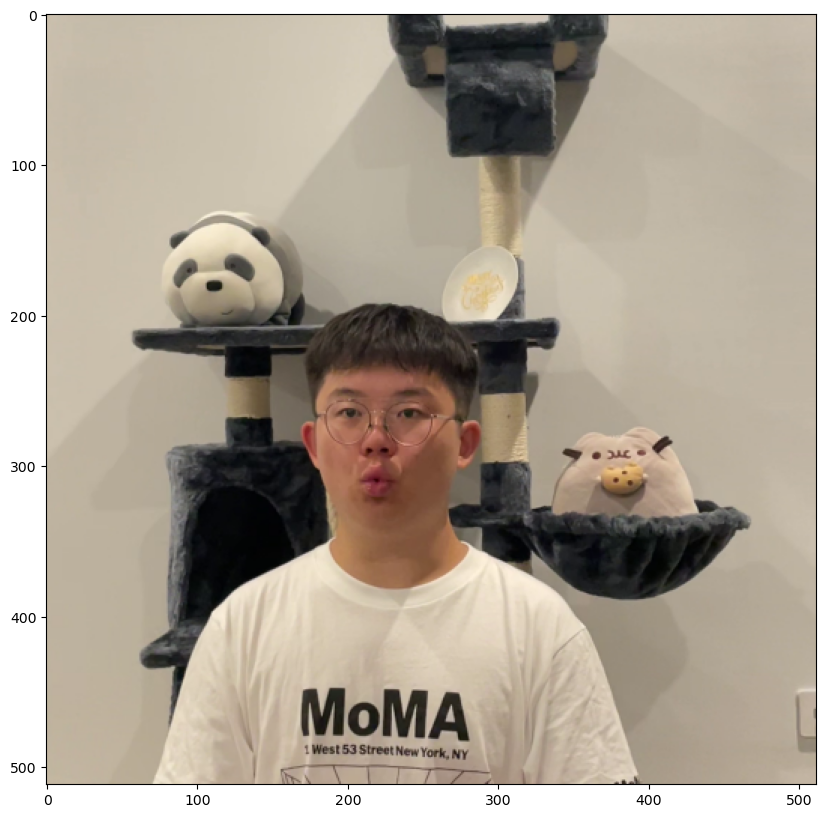

In [5]:
import plotly.graph_objs as go
import cv2
from matplotlib import pyplot as plt
image_names = os.listdir(rgb_path)
if not random_check:
# Select a fixed image
    image_name_sample_1 = "p2_000200.png"
else:
    # randomly select an image
    image_name_sample_1 = random.choice(image_names)
print(image_name_sample_1)

fig = go.Figure()
# render image and deformed, canonical mesh

image_path = os.path.join(rgb_path, image_name_sample_1)
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
image_id = image_name_sample_1.split('.')[0]
deca_deformed_mesh = get_DECA_deform_mesh(image_id)
if image_id.startswith('p2'):
    deca_canonical_mesh = get_DECA_canonical_mesh(image_id)
else:
    deca_canonical_mesh = None
# plot vertices, 2D keypoints and 3D keypoints on image
# plt.figure(figsize=(10,10))
# plt.imshow(image)

fig.add_trace(go.Scatter3d(
    x=deca_deformed_mesh[:, 0],
    y=deca_deformed_mesh[:, 1],
    z=deca_deformed_mesh[:, 2],
    mode='markers',
    marker=dict(size=2),
))
# if deca_canonical_mesh is not None:
#     fig.add_trace(go.Scatter3d(
#         x=deca_canonical_mesh[:, 0],
#         y=deca_canonical_mesh[:, 1],
#         z=deca_canonical_mesh[:, 2],
#         mode='markers',
#         marker=dict(size=2),
#     ))
    

# render image and deformed, canonical mesh
image_name_sample = "p2_000892.png"
image_path = os.path.join(rgb_path, image_name_sample)
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
image_id = image_name_sample.split('.')[0]
deca_deformed_mesh = get_DECA_deform_mesh(image_id)
# plot vertices, 2D keypoints and 3D keypoints on image
# plt.figure(figsize=(10,10))
# plt.imshow(image)

fig.add_trace(go.Scatter3d(
    x=deca_deformed_mesh[:, 0],
    y=deca_deformed_mesh[:, 1],
    z=deca_deformed_mesh[:, 2],
    mode='markers',
    marker=dict(size=2),
))

fig.update_layout(scene_dragmode='orbit')
fig.show()

### Show DECA 2D vertices

p3_000609.png


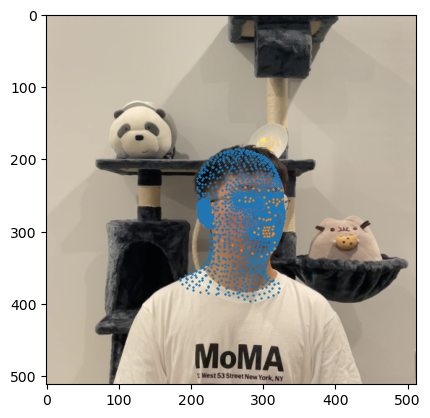

In [5]:
image_names = os.listdir(rgb_path)
if not random_check:
# Select a fixed image
    image_name_sample = "p3_000440.png"
else:
    # randomly select an image
    image_name_sample = random.choice(image_names)
print(image_name_sample)

image_path = os.path.join(rgb_path, image_name_sample)
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
image_id = image_name_sample.split('.')[0]
verts_2D,landmarks_2D = get_2D_points(image_id,image.shape[1],image.shape[0])
plt.imshow(image)
plt.scatter(verts_2D[:,0],verts_2D[:,1],s=0.5)
plt.scatter(landmarks_2D[:,0],landmarks_2D[:,1],s=0.5)
plt.show()


## Process Colmap data (based on nerfies)

In [6]:
# @title Define Scene Manager.
from absl import logging
from typing import Dict
import numpy as np
from nerfies.camera import Camera
import pycolmap
from pycolmap import Quaternion
from pathlib import Path
import cv2

def convert_colmap_camera(colmap_camera, colmap_image):
    """Converts a pycolmap `image` to an SFM camera.
    SFM camera is the defined camera class (in nerfies camera.py)
    """

    camera_rotation = colmap_image.R()
    camera_position = -(colmap_image.t @ camera_rotation)
    #print(colmap_camera)
    # Model, width, height, f (focal), cx, cy (principal point), k(distortion)
    # SIMPLE_RADIAL 540 960 829.4165762600147 270.0 480.0 -0.02138539392187597
    new_camera = Camera(
      orientation=camera_rotation,
      position=camera_position,
      focal_length=colmap_camera.fx,
      pixel_aspect_ratio=colmap_camera.fx / colmap_camera.fx,
      principal_point=np.array([colmap_camera.cx, colmap_camera.cy]),
      radial_distortion=np.array([colmap_camera.k1, colmap_camera.k1, 0.0]),
      #tangential_distortion=np.array([colmap_camera.p1, colmap_camera.p2]),
      skew=0.0,
      image_size=np.array([colmap_camera.width, colmap_camera.height])
    )
    return new_camera


def _pycolmap_to_sfm_cameras(manager: pycolmap.SceneManager) -> Dict[int, Camera]:
    """Creates SFM cameras."""
  # Use the original filenames as indices.
  # This mapping necessary since COLMAP uses arbitrary numbers for the
  # image_id.
    image_id_to_colmap_id = {
      image.name.split('.')[0]: image_id
      for image_id, image in manager.images.items()
    }

    sfm_cameras = {}
    for image_id in image_id_to_colmap_id:
        colmap_id = image_id_to_colmap_id[image_id]
        image = manager.images[colmap_id]
        camera = manager.cameras[image.camera_id]
        sfm_cameras[image_id] = convert_colmap_camera(camera, image)

    return sfm_cameras


class SceneManager:
    """A thin wrapper around pycolmap."""

    @classmethod
    def from_pycolmap(cls, colmap_path, image_path, min_track_length=10):
        """Create a scene manager using pycolmap."""
        manager = pycolmap.SceneManager(str(colmap_path))
        manager.load_cameras()
        manager.load_images()
        manager.load_points3D()
        manager.filter_points3D(min_track_len=min_track_length)
        sfm_cameras = _pycolmap_to_sfm_cameras(manager)
        return cls(sfm_cameras, manager.get_filtered_points3D(), image_path)

    def __init__(self, cameras, points, image_path):
        self.image_path = Path(image_path)
        self.camera_dict = cameras
        self.points = points

        logging.info('Created scene manager with %d cameras', len(self.camera_dict))

    def __len__(self):
        return len(self.camera_dict)

    @property
    def image_ids(self):
        return sorted(self.camera_dict.keys())

    @property
    def camera_list(self):
        return [self.camera_dict[i] for i in self.image_ids]

    @property
    def camera_positions(self):
        """Returns an array of camera positions."""
        return np.stack([camera.position for camera in self.camera_list])

    def load_image(self, image_id):
        """Loads the image with the specified image_id."""
        path = self.image_path / f'{image_id}.png'
        with path.open('rb') as f:
            return imageio.imread(f)

2023-05-02 18:32:34.778391: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F AVX512_VNNI FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-05-02 18:32:34.887917: I tensorflow/core/util/port.cc:104] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-05-02 18:32:34.891566: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /data/gpfs/projects/punim1485/kuoyuanl/anaconda3/envs/rignerf/lib/python3.8/site-pa

In [7]:
from pathlib import Path
scene_manager = SceneManager.from_pycolmap(
    os.path.join(colmap_dir, 'sparse/0'), 
    rgb_path, 
    min_track_length=5)

# colmap_image_scale=4 
# if colmap_image_scale > 1:
#   print(f'Scaling COLMAP cameras back to 1x from {colmap_image_scale}x.')
#   for item_id in scene_manager.image_ids:
#     camera = scene_manager.camera_dict[item_id]
#     scene_manager.camera_dict[item_id] = camera.scale((1/colmap_image_scale))

# filter outlier points
import copy 
filtered_points = copy.deepcopy(scene_manager.points)
filtered_points = np.array([i for i in filtered_points if i[2]<50])
# store the filtered points in a file
filtered_points_path = os.path.join(colmap_dir, 'filtered_points.npy')
np.save(filtered_points_path, filtered_points)
fig = go.Figure()
fig.add_trace(go.Scatter3d(
    x=filtered_points[:, 0],
    y=filtered_points[:, 1],
    z=filtered_points[:, 2],
    mode='markers',
    marker=dict(size=2),
))
fig.add_trace(go.Scatter3d(
    x=scene_manager.camera_positions[:, 0],
    y=scene_manager.camera_positions[:, 1],
    z=scene_manager.camera_positions[:, 2],
    mode='markers',
    marker=dict(size=2),
))
fig.update_layout(scene_dragmode='orbit')
fig.show()

### Check Camera pose matrix and focal length

In [8]:
check_id = "p1_000001"
print(scene_manager.camera_dict[check_id].position)
print(scene_manager.camera_dict[check_id].orientation)
print(scene_manager.camera_dict[check_id].focal_length)

[ 0.24163926 -0.38076547  0.52232313]
[[ 0.999633   -0.00507183 -0.02661053]
 [ 0.00619734  0.99908215  0.04238517]
 [ 0.02637114 -0.04253453  0.99874693]]
829.455


## Triangulate mesh

/tmp/ipykernel_24967/773499851.py:96: DeprecationWarning:

Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.



p1_000000


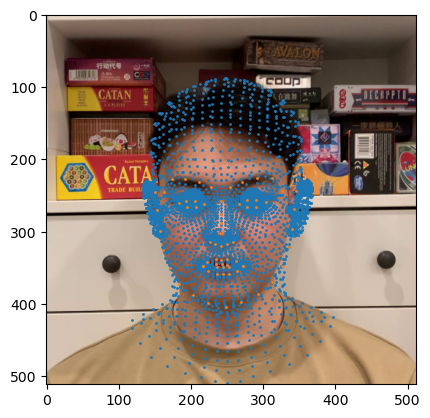

p1_000080


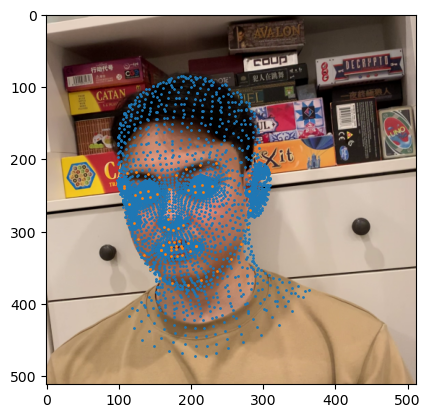

p1_000160


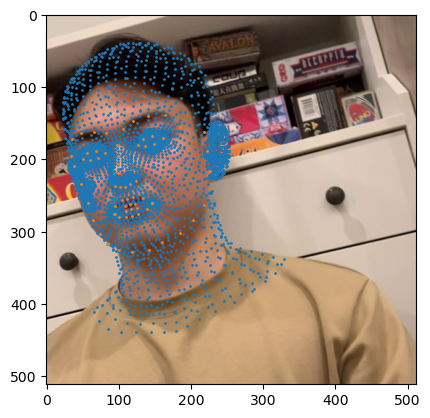

p1_000240


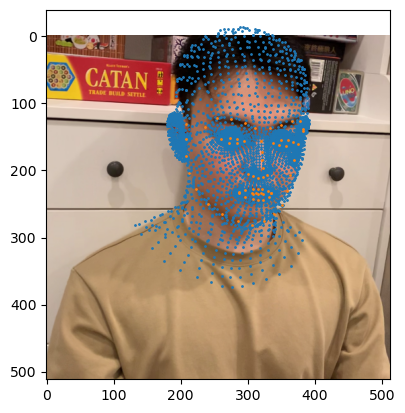

p1_000400


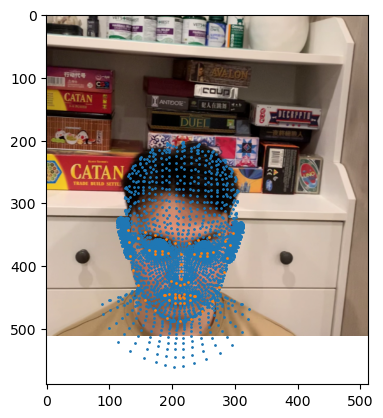

p1_000480


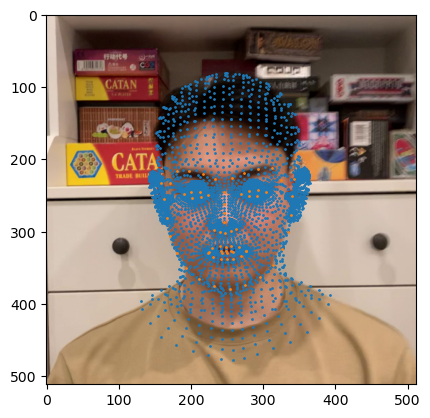

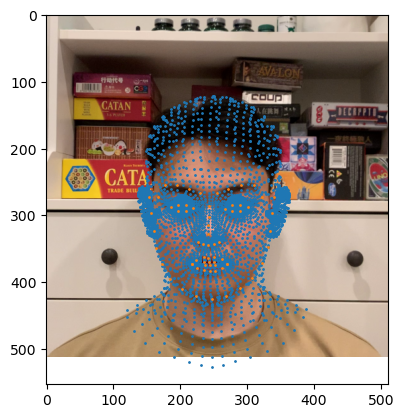

In [9]:
from tensorflow_graphics.geometry.representation.ray import triangulate as ray_triangulate
import imageio

verts_dict = {}
landmarks_dict = {}
# indexes_to_remove = np.load(to_remove_index_path)
for item_id in scene_manager.image_ids:
    # print(item_id)
    if not item_id.startswith('p1'):
        continue
    image = scene_manager.load_image(item_id)
    verts_2D, landmarks_2D = get_2D_points(item_id,image.shape[1],image.shape[0])
    # remove points where index is in to_remove_index
    # verts_2D = np.delete(verts_2D, indexes_to_remove, axis=0)
    if landmarks_2D is not None and verts_2D is not None:
        verts_dict[item_id] = verts_2D
        landmarks_dict[item_id] = landmarks_2D
    item_id_int = item_id.split('_')[-1]
    if int(item_id_int) % 80 == 0:
        print(item_id)
        plt.imshow(image)
        plt.scatter(verts_2D[:,0],verts_2D[:,1],s=1)
        plt.scatter(landmarks_2D[:,0],landmarks_2D[:,1],s=1)
        plt.show()
        
landmark_item_ids = sorted(landmarks_dict) # sort landmarks dict based on its key (item_id)
landmarks_pixels = np.array([landmarks_dict[i] for i in landmark_item_ids]) # sort the landmark pixels for all frames, shape: (3902, 68, 2)
landmarks_cameras = [scene_manager.camera_dict[i] for i in landmark_item_ids] 

verts_item_ids = sorted(verts_dict) # sort landmarks dict based on its key (item_id)
verts_pixels = np.array([verts_dict[i] for i in verts_item_ids]) # sort the landmark pixels for all frames, shape: (3902, 68, 2)
verts_cameras = [scene_manager.camera_dict[i] for i in verts_item_ids]

from matplotlib import pyplot as plt
plt.imshow(image)
plt.scatter(x=verts_2D[..., 0], y=verts_2D[..., 1], s=1);
plt.scatter(x=landmarks_2D[..., 0], y=landmarks_2D[..., 1], s=1);

In [10]:
def compute_camera_rays(points, camera):
    origins = np.broadcast_to(camera.position[None, :], (points.shape[0], 3))
    directions = camera.pixels_to_rays(points.astype(np.float32))
    endpoints = origins + directions
    return origins, endpoints
  
  
def triangulate_landmarks(landmarks, cameras):
    all_origins = []
    all_endpoints = []
    nan_inds = []
    for i, (camera_landmarks, camera) in enumerate(zip(landmarks, cameras)):
        origins, endpoints = compute_camera_rays(camera_landmarks, camera)
        if np.isnan(origins).sum() > 0.0 or np.isnan(endpoints).sum() > 0.0:
            continue
        all_origins.append(origins)
        all_endpoints.append(endpoints)
    all_origins = np.stack(all_origins, axis=-2).astype(np.float32)
    all_endpoints = np.stack(all_endpoints, axis=-2).astype(np.float32)
    weights = np.ones(all_origins.shape[:2], dtype=np.float32)
    points = np.array(ray_triangulate(all_origins, all_endpoints, weights))

    return points


verts_points = triangulate_landmarks(verts_pixels, verts_cameras) # use the first 1290 frames to get 3D points (one "world")
  

2023-05-02 18:33:09.489357: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /data/gpfs/projects/punim1485/kuoyuanl/anaconda3/envs/rignerf/lib/python3.8/site-packages/cv2/../../lib64:
2023-05-02 18:33:09.489421: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcublas.so.11'; dlerror: libcublas.so.11: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /data/gpfs/projects/punim1485/kuoyuanl/anaconda3/envs/rignerf/lib/python3.8/site-packages/cv2/../../lib64:
2023-05-02 18:33:09.489463: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcublasLt.so.11'; dlerror: libcublasLt.so.11: cannot open shared object file: No such file or directory; LD_LIBRARY_PATH: /data/g

### Show triangulated mesh in COLMAP

In [11]:
fig = go.Figure()
# filter scene_manager points
filtered_points = copy.deepcopy(scene_manager.points)
filtered_points = np.array([i for i in filtered_points if i[2]<30])
fig.add_trace(go.Scatter3d(
    x=filtered_points[:, 0],
    y=filtered_points[:, 1],
    z=filtered_points[:, 2],
    mode='markers',
    marker=dict(size=2),
))
fig.add_trace(go.Scatter3d(
    x=scene_manager.camera_positions[:, 0],
    y=scene_manager.camera_positions[:, 1],
    z=scene_manager.camera_positions[:, 2],
    mode='markers',
    marker=dict(size=2),
))
fig.add_trace(go.Scatter3d(
    x=verts_points[:, 0],
    y=verts_points[:, 1],
    z=verts_points[:, 2],
    mode='markers',
    marker=dict(size=2),
))
fig.update_layout(scene_dragmode='orbit')
fig.show()

## Transform mesh from DECA coordinates to Colmap coordinates

In [12]:
# Similarity transformation
# Based on https://github.com/mapillary/OpenSfM/blob/61a98f6ab0f2d7b12592a92436648bd276f603d8/opensfm/transformations.py#L883
import numpy
import math
_EPS = numpy.finfo(float).eps * 4.0

def quaternion_matrix(quaternion):
    """Return homogeneous rotation matrix from quaternion.
    >>> M = quaternion_matrix([0.99810947, 0.06146124, 0, 0])
    >>> numpy.allclose(M, rotation_matrix(0.123, [1, 0, 0]))
    True
    >>> M = quaternion_matrix([1, 0, 0, 0])
    >>> numpy.allclose(M, numpy.identity(4))
    True
    >>> M = quaternion_matrix([0, 1, 0, 0])
    >>> numpy.allclose(M, numpy.diag([1, -1, -1, 1]))
    True
    """
    q = numpy.array(quaternion, dtype=numpy.float64, copy=True)
    n = numpy.dot(q, q)
    if n < _EPS:
        return numpy.identity(4)
    q *= math.sqrt(2.0 / n)
    q = numpy.outer(q, q)
    return numpy.array([
        [1.0-q[2, 2]-q[3, 3],     q[1, 2]-q[3, 0],     q[1, 3]+q[2, 0], 0.0],
        [    q[1, 2]+q[3, 0], 1.0-q[1, 1]-q[3, 3],     q[2, 3]-q[1, 0], 0.0],
        [    q[1, 3]-q[2, 0],     q[2, 3]+q[1, 0], 1.0-q[1, 1]-q[2, 2], 0.0],
        [                0.0,                 0.0,                 0.0, 1.0]])

def vector_norm(data, axis=None, out=None):
    """Return length, i.e. Euclidean norm, of ndarray along axis.
    >>> v = numpy.random.random(3)
    >>> n = vector_norm(v)
    >>> numpy.allclose(n, numpy.linalg.norm(v))
    True
    >>> v = numpy.random.rand(6, 5, 3)
    >>> n = vector_norm(v, axis=-1)
    >>> numpy.allclose(n, numpy.sqrt(numpy.sum(v*v, axis=2)))
    True
    >>> n = vector_norm(v, axis=1)
    >>> numpy.allclose(n, numpy.sqrt(numpy.sum(v*v, axis=1)))
    True
    >>> v = numpy.random.rand(5, 4, 3)
    >>> n = numpy.empty((5, 3))
    >>> vector_norm(v, axis=1, out=n)
    >>> numpy.allclose(n, numpy.sqrt(numpy.sum(v*v, axis=1)))
    True
    >>> vector_norm([])
    0.0
    >>> vector_norm([1])
    1.0
    """
    data = numpy.array(data, dtype=numpy.float64, copy=True)
    if out is None:
        if data.ndim == 1:
            return math.sqrt(numpy.dot(data, data))
        data *= data
        out = numpy.atleast_1d(numpy.sum(data, axis=axis))
        numpy.sqrt(out, out)
        return out
    else:
        data *= data
        numpy.sum(data, axis=axis, out=out)
        numpy.sqrt(out, out)

        
def affine_matrix_from_points(v0, v1, shear=False, scale=True, usesvd=False):
    """Return affine transform matrix to register two point sets.
    v0 and v1 are shape (ndims, \*) arrays of at least ndims non-homogeneous
    coordinates, where ndims is the dimensionality of the coordinate space.
    If shear is False, a similarity transformation matrix is returned.
    If also scale is False, a rigid/Euclidean transformation matrix
    is returned.
    By default the algorithm by Hartley and Zissermann [15] is used.
    If usesvd is True, similarity and Euclidean transformation matrices
    are calculated by minimizing the weighted sum of squared deviations
    (RMSD) according to the algorithm by Kabsch [8].
    Otherwise, and if ndims is 3, the quaternion based algorithm by Horn [9]
    is used, which is slower when using this Python implementation.
    The returned matrix performs rotation, translation and uniform scaling
    (if specified).
    >>> numpy.set_printoptions(precision=5, suppress=True)
    >>> v0 = [[0, 1031, 1031, 0], [0, 0, 1600, 1600]]
    >>> v1 = [[675, 826, 826, 677], [55, 52, 281, 277]]
    >>> affine_matrix_from_points(v0, v1)
    array([[   0.14549,    0.00062,  675.50008],
           [   0.00048,    0.14094,   53.24971],
           [   0.     ,    0.     ,    1.     ]])
    >>> T = translation_matrix(numpy.random.random(3)-0.5)
    >>> R = random_rotation_matrix(numpy.random.random(3))
    >>> S = scale_matrix(numpy.random.random())
    >>> M = concatenate_matrices(T, R, S)
    >>> v0 = (numpy.random.rand(4, 100) - 0.5) * 20
    >>> v0[3] = 1
    >>> v1 = numpy.dot(M, v0)
    >>> v0[:3] += numpy.random.normal(0, 1e-8, 300).reshape(3, -1)
    >>> M = affine_matrix_from_points(v0[:3], v1[:3])
    >>> numpy.allclose(v1, numpy.dot(M, v0))
    True
    More examples in superimposition_matrix()
    """
    # Make [[x1,y1,z1],[x2,y2,z2]] to [[x1,x2],[y1,y2],[z1,z2]]
    v0 = numpy.array(v0.T, dtype=numpy.float64, copy=True)
    v1 = numpy.array(v1.T, dtype=numpy.float64, copy=True)

    ndims = v0.shape[0]
    if ndims < 2 or v0.shape[1] < ndims or v0.shape != v1.shape:
        raise ValueError("input arrays are of wrong shape or type")

    # move centroids to origin
    t0 = -numpy.mean(v0, axis=1)
    M0 = numpy.identity(ndims+1)
    M0[:ndims, ndims] = t0
    v0 += t0.reshape(ndims, 1)
    t1 = -numpy.mean(v1, axis=1)
    M1 = numpy.identity(ndims+1)
    M1[:ndims, ndims] = t1
    v1 += t1.reshape(ndims, 1)

    if shear:
        # Affine transformation
        A = numpy.concatenate((v0, v1), axis=0)
        u, s, vh = numpy.linalg.svd(A.T)
        vh = vh[:ndims].T
        B = vh[:ndims]
        C = vh[ndims:2*ndims]
        t = numpy.dot(C, numpy.linalg.pinv(B))
        t = numpy.concatenate((t, numpy.zeros((ndims, 1))), axis=1)
        M = numpy.vstack((t, ((0.0,)*ndims) + (1.0,)))
    elif usesvd or ndims != 3:
        # Rigid transformation via SVD of covariance matrix
        u, s, vh = numpy.linalg.svd(numpy.dot(v1, v0.T))
        # rotation matrix from SVD orthonormal bases
        R = numpy.dot(u, vh)
        if numpy.linalg.det(R) < 0.0:
            # R does not constitute right handed system
            R -= numpy.outer(u[:, ndims-1], vh[ndims-1, :]*2.0)
            s[-1] *= -1.0
        # homogeneous transformation matrix
        M = numpy.identity(ndims+1)
        M[:ndims, :ndims] = R
    else:
        # Rigid transformation matrix via quaternion
        # compute symmetric matrix N
        xx, yy, zz = numpy.sum(v0 * v1, axis=1)
        xy, yz, zx = numpy.sum(v0 * numpy.roll(v1, -1, axis=0), axis=1)
        xz, yx, zy = numpy.sum(v0 * numpy.roll(v1, -2, axis=0), axis=1)
        N = [[xx+yy+zz, 0.0,      0.0,      0.0],
             [yz-zy,    xx-yy-zz, 0.0,      0.0],
             [zx-xz,    xy+yx,    yy-xx-zz, 0.0],
             [xy-yx,    zx+xz,    yz+zy,    zz-xx-yy]]
        # quaternion: eigenvector corresponding to most positive eigenvalue
        w, V = numpy.linalg.eigh(N)
        q = V[:, numpy.argmax(w)]
        q /= vector_norm(q)  # unit quaternion
        # homogeneous transformation matrix
        M = quaternion_matrix(q)

    if scale and not shear:
        # Affine transformation; scale is ratio of RMS deviations from centroid
        v0 *= v0
        v1 *= v1
        M[:ndims, :ndims] *= math.sqrt(numpy.sum(v1) / numpy.sum(v0))

    # move centroids back
    M = numpy.dot(numpy.linalg.inv(M1), numpy.dot(M, M0))
    M /= M[ndims, ndims]
    return M

### Use the transformed canonical mesh at first scene as the only canonical mesh

In [13]:
deca_mesh = get_DECA_deform_mesh('p3_000000')
# deca_mesh_rem = np.delete(deca_mesh, indexes_to_remove, axis=0)
transformation_canonical = affine_matrix_from_points(deca_mesh,verts_points)
z = np.ones((deca_mesh.shape[0],1), dtype=float)
deca_mesh = np.append(deca_mesh, z, axis=1)
canonical_transform = np.array([np.matmul(transformation_canonical,row) for row in deca_mesh])
deca_transformed_file = os.path.join(deca_canonical_new,'canonical_mesh_colmap_coordinate')
if not os.path.exists(deca_canonical_new):
    os.mkdir(deca_canonical_new)
np.save(deca_transformed_file,canonical_transform[:,:3])

### Calculate coordinate transformation between DECA and COLMAP for each frame (part 2)

In [14]:
import cv2
from tqdm import tqdm
import numpy as np
def coordinate_transformation(colmap_mesh,canonical_mesh,deformed_mesh):
    # the transformation should be a similarity transformation
    # Similarity transformation includes translation, rotation and isotropic Scaling
    transformation = affine_matrix_from_points(canonical_mesh,colmap_mesh)
    z = np.ones((deformed_mesh.shape[0],1), dtype=float)
    deformed_mesh = np.append(deformed_mesh, z, axis=1)
    deformed_transform = np.array([np.matmul(transformation,row) for row in deformed_mesh])
    return deformed_transform[:,:3]

if not os.path.exists(deca_deformed_new):
    os.mkdir(deca_deformed_new)
             
for image_id in tqdm(scene_manager.image_ids):
    if not image_id.startswith('p2'):
        continue
    deca_deformed_mesh = get_DECA_deform_mesh(image_id)
    deca_canonical_mesh = get_DECA_canonical_mesh(image_id)
    # deca_canonical_mesh_rem = np.delete(deca_canonical_mesh, indexes_to_remove, axis=0)
    deformed_transform = coordinate_transformation(verts_points,deca_canonical_mesh,deca_deformed_mesh)
    deca_deformed_transformed_file = os.path.join(deca_deformed_new,'{}_mesh_colmap_coordinate'.format(image_id))
    np.save(deca_deformed_transformed_file,deformed_transform)

100%|██████████| 2108/2108 [00:18<00:00, 111.61it/s]


### Calculate coordinate transformation between DECA and COLMAP for each frame (part 3)

In [15]:
CANONICAL_FOR_PHASE2 = 'p3_000000'
deca_mesh = get_DECA_deform_mesh(CANONICAL_FOR_PHASE2)
# calculate transformation matrix 
# deca_mesh_rem = np.delete(deca_mesh,indexes_to_remove, axis=0)
tf_phase2 = affine_matrix_from_points(deca_mesh,verts_points)

if not os.path.exists(deca_deformed_new):
    os.mkdir(deca_deformed_new)
for image_id in tqdm(scene_manager.image_ids):
    if not image_id.startswith('p3'):
        continue
    deca_deformed_mesh = get_DECA_deform_mesh(image_id)
    z = np.ones((deca_deformed_mesh.shape[0],1), dtype=float)
    deformed_mesh = np.append(deca_deformed_mesh, z, axis=1)
    deformed_transform = np.array([np.matmul(tf_phase2,row) for row in deformed_mesh])
    deformed_transform = deformed_transform[:,:3]
    deca_deformed_transformed_file = os.path.join(deca_deformed_new,'{}_mesh_colmap_coordinate'.format(image_id))
    np.save(deca_deformed_transformed_file,deformed_transform)

100%|██████████| 2108/2108 [00:18<00:00, 111.73it/s]  


### Randomly pick a transformed deform mesh, show it with canonical mesh (colmap), scene points and camera points

p3_000607.png


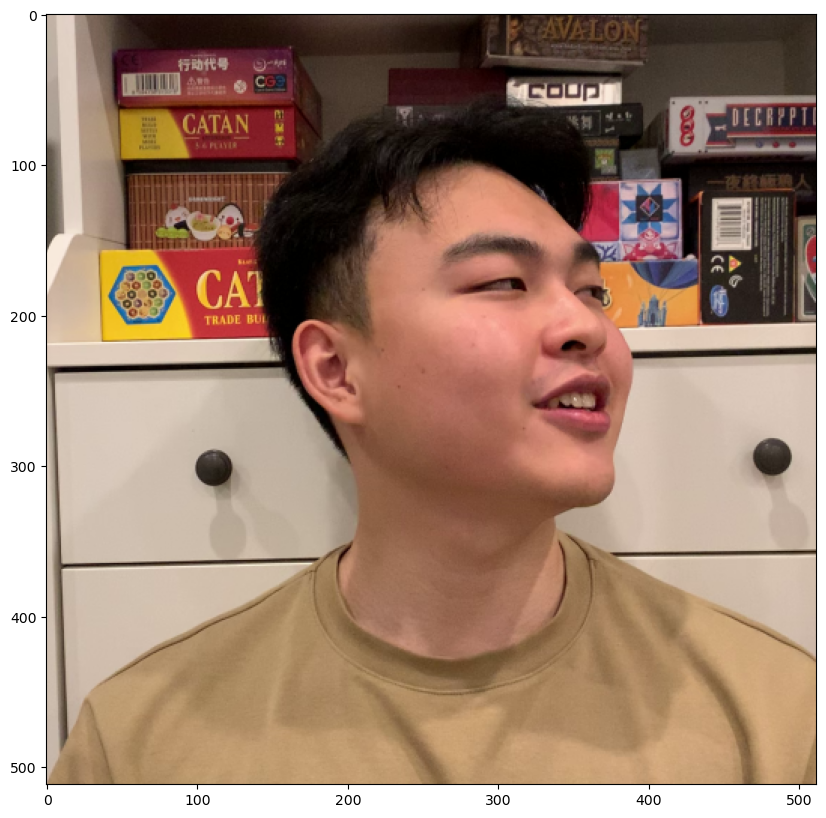

In [16]:
image_names = os.listdir(rgb_path)
if not random_check:
# Select a fixed image
    image_name_sample = "p2_000200.png"
else:
    while True:
        image_name_sample = random.choice(scene_manager.image_ids)
        if not image_name_sample.startswith('p1'):
            break
    image_name_sample += '.png'
print(image_name_sample)

# draw image   
image_path = os.path.join(rgb_path, image_name_sample)
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
image_id = image_name_sample.split('.')[0]
plt.figure(figsize=(10,10))
plt.imshow(image)

# plot image
fig = go.Figure()
fig.add_trace(go.Scatter3d(
    x=filtered_points[:, 0],
    y=filtered_points[:, 1],
    z=filtered_points[:, 2],
    mode='markers',
    marker=dict(size=2),
))
fig.add_trace(go.Scatter3d(
    x=scene_manager.camera_positions[:, 0],
    y=scene_manager.camera_positions[:, 1],
    z=scene_manager.camera_positions[:, 2],
    mode='markers',
    marker=dict(size=2),
))

# load canonical mesh and random deformed mesh
deformed_mesh_sample = np.load(os.path.join(deca_deformed_new,image_id+'_mesh_colmap_coordinate.npy'))
canonical_mesh = np.load(os.path.join(deca_canonical_new,'canonical_mesh_colmap_coordinate.npy'))
fig.add_trace(go.Scatter3d(
    x=canonical_mesh[:, 0],
    y=canonical_mesh[:, 1],
    z=canonical_mesh[:, 2],
    mode='markers',
    marker=dict(size=2),
))
fig.add_trace(go.Scatter3d(
    x=deformed_mesh_sample[:, 0],
    y=deformed_mesh_sample[:, 1],
    z=deformed_mesh_sample[:, 2],
    mode='markers',
    marker=dict(size=2),
))
fig.update_layout(scene_dragmode='orbit')
fig.show()

## Check the camera pose and orientation

p3_000926.png
[1.02045335e-04 9.64898849e-04 9.99999523e-01]


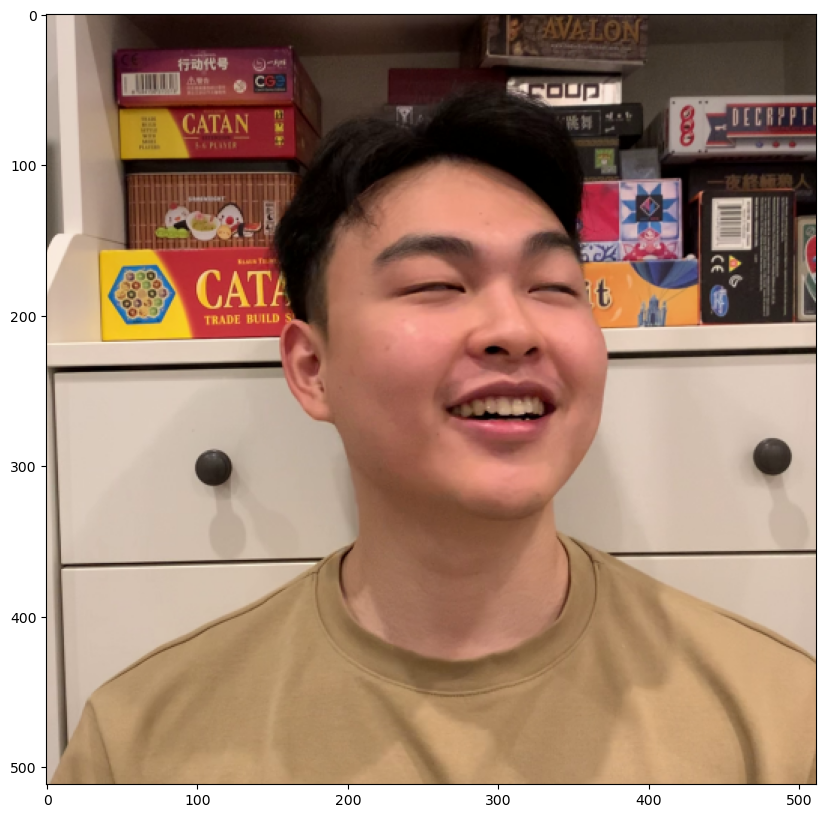

In [17]:
image_names = os.listdir(rgb_path)
if not random_check:
# Select a fixed image
    image_name_sample = "p1_000001.png"
else:
    # randomly select an image
    image_name_sample = random.choice(image_names)
print(image_name_sample)

# draw image   
image_path = os.path.join(rgb_path, image_name_sample)
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
image_id = image_name_sample.split('.')[0]
plt.figure(figsize=(10,10))
plt.imshow(image)

# load camera 
camera = scene_manager.camera_dict[image_id]
camera_pose = camera.orientation
camera_ori = camera.position
print(camera_pose[2,:])
middle_ray = np.asarray([camera_ori+i*camera_pose[2,:] for i in range(0,20)])
# plot image
fig = go.Figure()
fig.add_trace(go.Scatter3d(
    x=filtered_points[:, 0],
    y=filtered_points[:, 1],
    z=filtered_points[:, 2],
    mode='markers',
    marker=dict(size=2),
))
fig.add_trace(go.Scatter3d(
    x=scene_manager.camera_positions[:, 0],
    y=scene_manager.camera_positions[:, 1],
    z=scene_manager.camera_positions[:, 2],
    mode='markers',
    marker=dict(size=2),
))
fig.add_trace(go.Scatter3d(
    x=camera_ori[[0]],
    y=camera_ori[[1]],
    z=camera_ori[[2]],
    mode='markers',
    marker=dict(size=2),
))
fig.add_trace(go.Scatter3d(
    x=middle_ray[:, 0],
    y=middle_ray[:, 1],
    z=middle_ray[:, 2],
    mode='markers',
    marker=dict(size=2),
))

# load canonical mesh and random deformed mesh
deformed_mesh_sample = np.load(os.path.join(deca_deformed_new,image_id+'_mesh_colmap_coordinate.npy'))
canonical_mesh = np.load(os.path.join(deca_canonical_new,'canonical_mesh_colmap_coordinate.npy'))
fig.add_trace(go.Scatter3d(
    x=canonical_mesh[:, 0],
    y=canonical_mesh[:, 1],
    z=canonical_mesh[:, 2],
    mode='markers',
    marker=dict(size=2),
))
fig.add_trace(go.Scatter3d(
    x=deformed_mesh_sample[:, 0],
    y=deformed_mesh_sample[:, 1],
    z=deformed_mesh_sample[:, 2],
    mode='markers',
    marker=dict(size=2),
))
fig.update_layout(scene_dragmode='orbit')
fig.show()

## Store information

### Store camera information

In [ ]:
# @title Save cameras.
import json
camera_dir = os.path.join(root_dir,'camera')
os.makedirs(camera_dir,exist_ok=True)
for item_id, camera in scene_manager.camera_dict.items():
    camera_path = os.path.join(camera_dir,f'{item_id}.json')
    print(f'Saving camera to {camera_path!s}')
    with open(camera_path,'w') as f:
        json.dump(camera.to_json(), f, indent=2)

### Store other necessary information

In [19]:
### Camera are already stored
check_id = "p1_000200"
print(scene_manager.camera_dict[check_id].orientation)
print(scene_manager.camera_dict[check_id].position)
print(scene_manager.camera_dict[check_id].focal_length)

KeyError: 'p1_000200'

In [ ]:
# Store scene.json
import json
scene_file = os.path.join(root_dir,"scene.json")
scene = {"near":8,"far":30}
with open(scene_file,'w') as file:
    json.dump(scene,file)

In [ ]:
# store dataset.json and metadata.json
all_ids = scene_manager.image_ids
val_ids = all_ids[::20]
train_ids = sorted(set(all_ids) - set(val_ids))
dataset_json = {
    'count': len(all_ids),
    'num_exemplars': len(train_ids),
    'ids': all_ids,
    'train_ids': train_ids,
    'val_ids': val_ids,
}

dataset_json_path = os.path.join(root_dir,'dataset.json')
with open(dataset_json_path,'w') as f:
    json.dump(dataset_json, f, indent=2)
print(f'Saved dataset information to {dataset_json_path}')

metadata_json = {}
for i, image_id in enumerate(train_ids):
      metadata_json[image_id] = {
          'warp_id': i,
          'appearance_id': i,
          'camera_id': 0,
      }
for i, image_id in enumerate(val_ids):
      metadata_json[image_id] = {
          'warp_id': 0,
          'appearance_id': 0,
          'camera_id': 0,
      }

metadata_json_path =  os.path.join(root_dir,'metadata.json')
with open(metadata_json_path,'w') as f:
    json.dump(metadata_json, f, indent=2)

print(f'Saved metadata information to {metadata_json_path}')


## Generate test cameras


In [ ]:
_EPSILON = 1e-5

def points_bound(points):
  """Computes the min and max dims of the points."""
  min_dim = np.min(points, axis=0)
  max_dim = np.max(points, axis=0)
  return np.stack((min_dim, max_dim), axis=1)


def points_centroid(points):
  """Computes the centroid of the points from the bounding box."""
  return points_bound(points).mean(axis=1)


def points_bounding_size(points):
  """Computes the bounding size of the points from the bounding box."""
  bounds = points_bound(points)
  return np.linalg.norm(bounds[:, 1] - bounds[:, 0])


def look_at(camera,
            camera_position: np.ndarray,
            look_at_position: np.ndarray,
            up_vector: np.ndarray):
  look_at_camera = camera.copy()
  optical_axis = look_at_position - camera_position
  norm = np.linalg.norm(optical_axis)
  if norm < _EPSILON:
    raise ValueError('The camera center and look at position are too close.')
  optical_axis /= norm

  right_vector = np.cross(optical_axis, up_vector)
  norm = np.linalg.norm(right_vector)
  if norm < _EPSILON:
    raise ValueError('The up-vector is parallel to the optical axis.')
  right_vector /= norm

  # The three directions here are orthogonal to each other and form a right
  # handed coordinate system.
  camera_rotation = np.identity(3)
  camera_rotation[0, :] = right_vector
  camera_rotation[1, :] = np.cross(optical_axis, right_vector)
  camera_rotation[2, :] = optical_axis

  look_at_camera.position = camera_position
  look_at_camera.orientation = camera_rotation
  return look_at_camera


In [ ]:
import math
from scipy import interpolate
from plotly.offline import iplot
import plotly.graph_objs as go


def compute_camera_rays(points, camera):
  origins = np.broadcast_to(camera.position[None, :], (points.shape[0], 3))
  directions = camera.pixels_to_rays(points.astype(jnp.float32))
  endpoints = origins + directions
  return origins, endpoints


def triangulate_rays(origins, directions):
  origins = origins[np.newaxis, ...].astype('float32')
  directions = directions[np.newaxis, ...].astype('float32')
  weights = np.ones(origins.shape[:2], dtype=np.float32)
  points = np.array(ray_triangulate(origins, origins + directions, weights))
  return points.squeeze()


ref_cameras = [c for c in scene_manager.camera_list]
origins = np.array([c.position for c in ref_cameras])
directions = np.array([c.optical_axis for c in ref_cameras])
look_at = triangulate_rays(origins, directions)
print('look_at', look_at)

avg_position = np.mean(origins, axis=0)
print('avg_position', avg_position)

up = -np.mean([c.orientation[..., 1] for c in ref_cameras], axis=0)
print('up', up)

bounding_size = points_bounding_size(origins) / 2
x_scale = 0.75
y_scale = 1.25
xs = x_scale * bounding_size
ys = y_scale * bounding_size
radius = 0.5  
num_frames = 200 


origin = np.zeros(3)

ref_camera = ref_cameras[0]
print(ref_camera.position)
z_offset = -0.1

angles = np.linspace(0, 2*math.pi, num=num_frames)
positions = []
for angle in angles:
  x = np.cos(angle) * radius * xs
  y = np.sin(angle) * radius * ys
  # x = xs * radius * np.cos(angle) / (1 + np.sin(angle) ** 2)
  # y = ys * radius * np.sin(angle) * np.cos(angle) / (1 + np.sin(angle) ** 2)

  position = np.array([x, y, z_offset])
  # Make distance to reference point constant.
  position = avg_position + position
  positions.append(position)

positions = np.stack(positions)

orbit_cameras = []
for position in positions:
  camera = ref_camera.look_at(position, look_at, up)
  orbit_cameras.append(camera)

camera_paths = {'orbit-mild': orbit_cameras}

fig = go.Figure()
fig.add_trace(go.Scatter3d(
    x=scene_manager.points[:, 0],
    y=scene_manager.points[:, 1],
    z=scene_manager.points[:, 2],
    mode='markers',
    marker=dict(size=2),
))
fig.add_trace(go.Scatter3d(
    x=look_at[[0]],
    y=look_at[[1]],
    z=look_at[[2]],
    mode='markers',
    marker=dict(size=2),
))
fig.add_trace(go.Scatter3d(
    x=scene_manager.camera_positions[:, 0],
    y=scene_manager.camera_positions[:, 1],
    z=scene_manager.camera_positions[:, 2],
    mode='markers',
    marker=dict(size=2),
))
fig.add_trace(go.Scatter3d(
    x=positions[:, 0],
    y=positions[:, 1],
    z=positions[:, 2],
    mode='markers',
    marker=dict(size=2),
))
fig.add_trace(go.Scatter3d(
    x=origins[:, 0],
    y=origins[:, 1],
    z=origins[:, 2],
    mode='markers',
    marker=dict(size=2),
))
fig.update_layout(scene_dragmode='orbit')
fig.show()

### Save generated test camera

In [ ]:
import json

test_camera_dir = os.path.join(root_dir, 'test_camera')
for test_path_name, test_cameras in camera_paths.items():
    out_dir = os.path.join(test_camera_dir,test_path_name)
    os.makedirs(out_dir,exist_ok=True)
    for i, camera in enumerate(test_cameras):
        camera_path = os.path.join(out_dir, f'{i:06d}.json')
        print(f'Saving camera to {camera_path!s}')
        with open(camera_path,'w') as f:
            json.dump(camera.to_json(), f, indent=2)